<a href="https://colab.research.google.com/github/maxmarkov/elections_analysis/blob/master/france_referendum_2005_notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Content



1.   Visualization of French administrative system on a map
2.   Referendum data: turnout and response rate distributions
3.   Visualization of the election results on a map
4.   Dispersion test per departement and per arrondissement (larger and smaller administrative units).



# French referendums. Geo visualization and statistical analysis.

The main idea of this project is to get familiar with geopandas and folium visualization packages working with the electoral data from the French referendums which took place in [2000](https://en.wikipedia.org/wiki/2000_French_constitutional_referendum) and [2005](https://en.wikipedia.org/wiki/2005_French_European_Constitution_referendum). Furthermore, we perform some statistical analysis of voting results as a function of turnout, visualize the results on a map and investigate the regions with low dispersion in the results.   


## 1. Administrative system of France with folium

We use a "département" division as an elementary unit. Overall there are 96 departments excluding the overseas territories like Guadeloupe, Martinique, la Réunion etc. Several "départements" group in the "région" unit with total of 13 regions, including Corsica. In turn, a "département" consists of several "arrondissement" with 322 arrondissements in total. The arrondissements are subdivided into 1,995 cantons . Read the [article on wikipedia](https://en.wikipedia.org/wiki/Administrative_divisions_of_France) for more details about French administrative system.

First, we install the required packages and visualize the administrative division of France on a map.

In [3]:
from IPython.display import clear_output

!pip install geopandas
!pip install folium
clear_output() # clean output after the installation
import geopandas
import folium

Load geo data from github and list the content of the repository.

In [4]:
!git clone https://github.com/gregoiredavid/france-geojson
clear_output()
%ls france-geojson

arrondissements-avec-outre-mer.geojson
arrondissements.geojson
arrondissements-version-simplifiee.geojson
cantons-avec-outre-mer.geojson
cantons.geojson
cantons-version-simplifiee.geojson
communes-avec-outre-mer.geojson
communes.geojson
communes-version-simplifiee.geojson
composer.json
departements/
departements-avec-outre-mer.geojson
departements.geojson
departements-version-simplifiee.geojson
metropole-et-outre-mer.geojson
metropole.geojson
metropole-version-simplifiee.geojson
README.md
regions/
regions-avant-redecoupage-2015.geojson
regions-avec-outre-mer.geojson
regions.geojson
regions-version-simplifiee.geojson


### Visualize the map with 13 "régions".

In [5]:
geofile = 'france-geojson/regions.geojson'
france_map = folium.Map(location=[45,5], zoom_start=5)
folium.Choropleth(geo_data=geofile,fill_opacity=0.7).add_to(france_map)
france_map

### Visualize the map with 96 "départements".

In [6]:
geofile_dpts = 'france-geojson/departements.geojson'
france_map = folium.Map(location=[45,5], zoom_start=5)
folium.Choropleth(geo_data=geofile_dpts,fill_opacity=0.7).add_to(france_map)
france_map

### Visualize the map with 322 "arrondissements"

In [7]:
geofile = 'france-geojson/arrondissements.geojson'
france_map = folium.Map(location=[45,5], zoom_start=5)
folium.Choropleth(geo_data=geofile,fill_opacity=0.7).add_to(france_map)
france_map

## 2. Referendum data.

All data can be found on the official French [web platform](https://www.data.gouv.fr/fr/) collecting the public data. There are web pages with the corresponding [2000](https://www.data.gouv.fr/fr/datasets/referendum-de-2000-resultats-par-bureaux-de-vote/) and [2005](https://www.data.gouv.fr/fr/datasets/referendum-de-2005-resultats-par-bureaux-de-vote/) referendum data. Data is summarized in a txt file. I downloaded it and erased some introduction lines to enable reading it directly with the csv reader from pandas. The data file is read from my google drive. The drive must be mounted first. The column names are given by hand with a list and correspond to:

1.  N° tour 
2.  Code région
3.  Code département
4.  Code arrondissement
5.  Code circonscription législative
6.  Code canton
7.  Code de la commune
8.  Inscrits de référence de la commune
9.  Nom de la commune 
10. N° de bureau de vote
11. Inscrits 
12. Votants 
13. Abstentions 
14. Exprimés
15. Réponse (OUI - NON)
16. Nombre de voix 

Let's see the head of the file:



In [8]:
import pandas as pd

# mount a google drive
from google.colab import drive
drive.mount('/content/gdrive')

column_names = ["numero_de_tour","code_region","code_departement","code_arrondissement","code_circonscription_legislative","code_canton","code_de_la_commune",
                "inscrits_de_reference_de_la_commune","nom_de_la_commune","numero_de_bureau_de_vote","inscrits","votants","abstentions","exprimes","Reponse",
                "Nombre_de_voix"]

data = pd.read_csv('gdrive/My Drive/elections_data/France_referendums/France_referendum_2005_copy.txt', sep=";", header=None, encoding='latin-1', names=column_names)
data.head()

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (2,9) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,numero_de_tour,code_region,code_departement,code_arrondissement,code_circonscription_legislative,code_canton,code_de_la_commune,inscrits_de_reference_de_la_commune,nom_de_la_commune,numero_de_bureau_de_vote,inscrits,votants,abstentions,exprimes,Reponse,Nombre_de_voix
0,1,82.0,01,2,4,10,1,602.0,L'Abergement-Clémenciat,0001,597,419,178,411,OUI,189
1,1,82.0,01,2,4,10,1,602.0,L'Abergement-Clémenciat,0001,597,419,178,411,NON,222
2,1,82.0,01,1,2,1,2,192.0,L'Abergement-de-Varey,0001,193,146,47,142,OUI,63
3,1,82.0,01,1,2,1,2,192.0,L'Abergement-de-Varey,0001,193,146,47,142,NON,79
4,1,82.0,01,1,2,1,4,7802.0,Ambérieu-en-Bugey,0001,955,594,361,584,OUI,240


Each of the 63986 election sites has one row with the result 'OUI' and another row with the result 'NON'.   

In [9]:
print('Total:', len(data))
print('OUI:', len(data[data['Reponse']=='OUI']))
print('NON:', len(data[data['Reponse']!='OUI']))
print('OUI+NON:', len(data[data['Reponse']=='OUI'])+len(data[data['Reponse']!='OUI']))
print(data['Reponse'].unique())

Total: 127972
OUI: 63986
NON: 63986
OUI+NON: 127972
['OUI' 'NON' 'NON  ']


Let's add the columns with the turnout percentage ("taux_de_participation") and the response percentage ("taux_de_reponse"). The former equals to the total number of people voted ("exprimés") to the number of people registered on a given site ("inscrits"). The latter we define as the ratio of number of people voted for the given option ("Nombre de voix") to the total number of people voted in total ("exprimés"). We multiply every ratio by 100 to convert it to the percentage.

In [10]:
data['taux_de_participation'] = data['exprimes']/data['inscrits']*100
data['taux_de_reponse'] = data['Nombre_de_voix']/data['exprimes']*100

Print the total turnout as well as the total voting percentage for and against. 

In [11]:
print('Total turnout is ', round(data['exprimes'].sum()/data['inscrits'].sum()*100,2),'%')
print('Votes for ', round(data[data['Reponse']=='OUI']['Nombre_de_voix'].sum()/data[data['Reponse']=='OUI']['exprimes'].sum()*100,2),'%')
print('Votes against ', round(data[data['Reponse']!='OUI']['Nombre_de_voix'].sum()/data[data['Reponse']!='OUI']['exprimes'].sum()*100,2),'%')

Total turnout is  68.26 %
Votes for  45.04 %
Votes against  54.96 %


For convenience, let's split the dataframe into two separate ones corresponding to 'OUI' and 'NON' answers.

In [12]:
data_oui = data[data['Reponse']=='OUI']
data_non = data[data['Reponse']!='OUI']

Now we look how the result depends on turnout rate. Each point represents data from a single election site ("bureaux de vote"). The result for "OUI" is in blue, the result for 'NON' is in red. We see two clusters with the opposite trends. At small turnout rate (less than 40%), the result 'OUI' wins (small cluster to the left), while at high turnout rate between 40 and 90 %, the result 'NON' wins.

Text(0, 0.5, 'Result, in %')

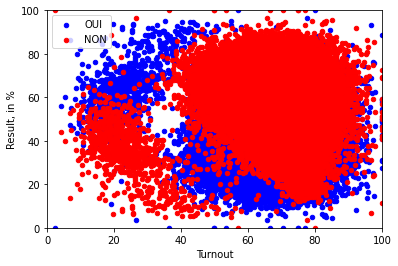

In [13]:
ax = data_oui.plot(kind='scatter', x='taux_de_participation', y='taux_de_reponse', color='Blue', label='OUI')
data_non.plot(kind='scatter', x='taux_de_participation', y='taux_de_reponse', color='Red', label='NON', ax=ax)
ax.set_xlim([0,100])
ax.set_ylim([0,100])
ax.set_xlabel('Turnout')
ax.set_ylabel('Result, in %')

Let's now plot the result rate histograms to see the frequency of the result for "OUI" (blue) and "NON".

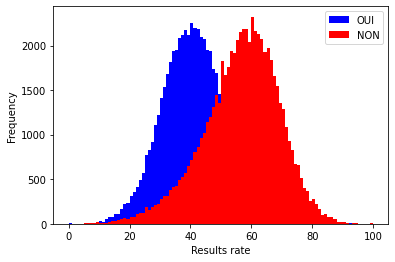

In [14]:
ax = data_oui['taux_de_reponse'].plot.hist(bins=100, color='blue', label='OUI')
data_non['taux_de_reponse'].plot.hist(bins=100, color='red', label='NON',ax=ax)
ax.set_xlabel('Results rate')
ax.legend()

Fit the histograms with the gaussian $f(x) = \frac{1}{\sigma \sqrt{2 \pi}}e^{-\left(\frac{x-\mu}{\sigma}\right)^2}$ and print the mean and standard deviation values for both options. Note that both curves are normalized i.e. one needs to multiply on the total number of people voted for the given response to restore the histograms above.

OUI: mean = 43.32 std = 12.46
NON: mean = 56.68 std = 12.46


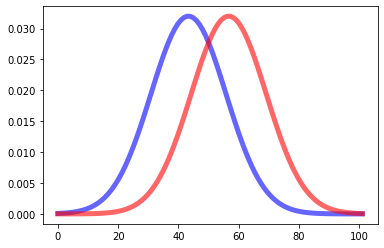

In [15]:
from scipy.stats import norm
import numpy as np
import matplotlib.pyplot as plt

def get_normal_dist(x):
   # get rid of some nan values
   x = x[np.isfinite(x)]
   # find the 
   mu, std = norm.fit(x)
   return(mu, std)

mu_oui, std_oui = get_normal_dist(data_oui['taux_de_reponse'].values)
print('OUI: mean =', round(mu_oui,2), 'std =', round(std_oui,2))
mu_non, std_non = get_normal_dist(data_non['taux_de_reponse'].values)
print('NON: mean =', round(mu_non,2), 'std =',round(std_non,2))
x = np.linspace(0, 101, 100)

fig, ax = plt.subplots(1, 1)
ax.plot(x, norm.pdf(x, mu_oui, std_oui),'b-', lw=5, alpha=0.6, label='oui fit')
ax.plot(x, norm.pdf(x, mu_non, std_non),'r-', lw=5, alpha=0.6, label='non fit')
plt.show()

Now we plot the turnout histogram. Since it is the same for both 'OUI' and 'NON' responses, it is enough to plot only one of the responses. We observe a small local peak with the turnout rate around 20 % corresponding to the small cluster in the left part of the Result VS turnout scatter plot. The main peak originates from the dense cluster in the right in the same figure.

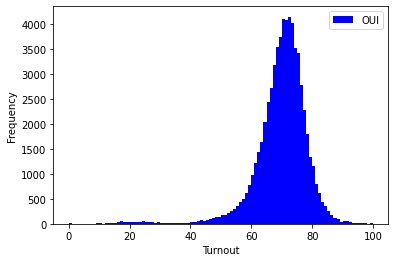

In [16]:
ax = data_oui['taux_de_participation'].plot.hist(bins=100, color='blue', label='OUI')
ax.set_xlabel('Turnout')
ax.legend()

Turnout: mean = 69.81 std = 8.92


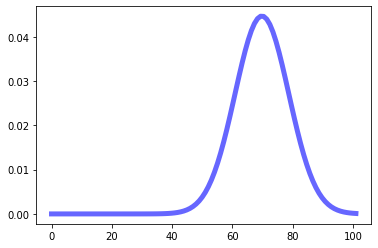

In [17]:
mu_tout, std_tout = get_normal_dist(data_oui['taux_de_participation'].values)
print('Turnout: mean =', round(mu_tout,2), 'std =',round(std_tout,2))
x = np.linspace(0, 101, 100)

fig, ax = plt.subplots(1, 1)
ax.plot(x, norm.pdf(x, mu_tout, std_tout),'b-', lw=5, alpha=0.6, label='oui fit')
plt.show()

Now let's make a plot with the total number of people voted for 'OUI' or 'NON' a a function of turnout.

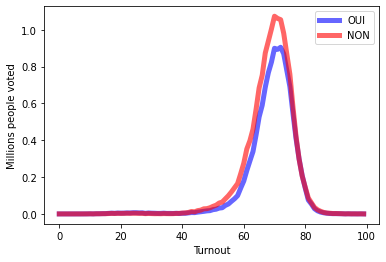

In [18]:
###### calculate results histogram in turnout bins################
def get_hist(df, bin_column='taux_de_participation', y_name='Nombre_de_voix', x_bins=np.arange(0,101,step=1.)):
    n_hist=[]
    for i in range(len(x_bins)-1):
        idx=(df[bin_column]>=x_bins[i])&(df[bin_column]<x_bins[i+1])
        n_candidate={}
        n_candidate[y_name]=np.sum(df[y_name][idx])     
        n_hist.append(n_candidate)        
    dhist=pd.DataFrame(n_hist)
    dhist['bin']=x_bins[:-1]
    return dhist

dhist_oui = get_hist(data_oui)
dhist_non = get_hist(data_non)

fig, ax = plt.subplots(1, 1)
ax.plot(dhist_oui['bin'], dhist_oui['Nombre_de_voix']*1e-6,'b-', lw=5, alpha=0.6, label='OUI')
ax.plot(dhist_non['bin'], dhist_non['Nombre_de_voix']*1e-6,'r-', lw=5, alpha=0.6, label='NON')
ax.set_xlabel('Turnout')
ax.set_ylabel('Millions people voted')
plt.legend()
plt.show()

Put the figures side by side

(0.0, 100.0)

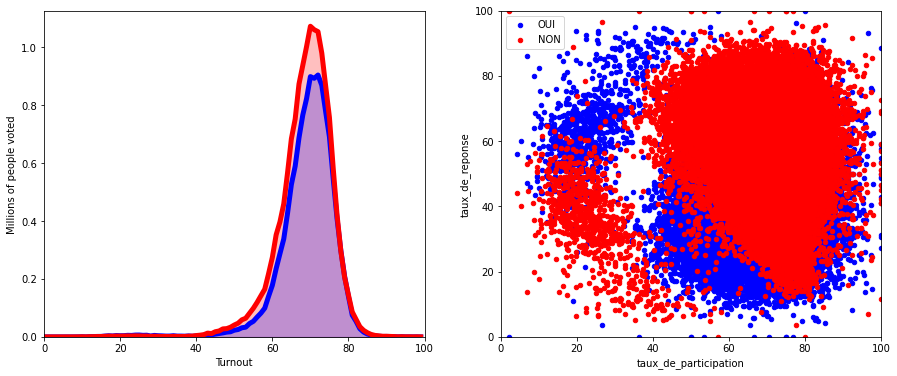

In [19]:
import matplotlib.pyplot as plt

fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(15,6))

ax1.plot(dhist_oui['bin'], dhist_oui['Nombre_de_voix']*1e-6,'b-', lw=5, label='OUI')
ax1.plot(dhist_non['bin'], dhist_non['Nombre_de_voix']*1e-6,'r-', lw=5, label='NON')
ax1.fill_between(dhist_non['bin'], 0, dhist_non['Nombre_de_voix']*1e-6, color='red', alpha=0.25)
ax1.fill_between(dhist_oui['bin'], 0, dhist_oui['Nombre_de_voix']*1e-6, color='blue', alpha=0.25)
ax1.set_xlabel('Turnout')
ax1.set_ylabel('Millions of people voted')
ax1.set_xlim([0,100])
ax1.set_ylim(ymin=0)

data[data['Reponse']=='OUI'].plot(kind='scatter', x='taux_de_participation', y='taux_de_reponse', color='Blue', label='OUI', ax=ax2)
data[data['Reponse']!='OUI'].plot(kind='scatter', x='taux_de_participation', y='taux_de_reponse', color='Red', label='NON', ax=ax2)
ax2.set_xlim([0,100])
ax2.set_ylim([0,100])

#fig.savefig('France_referendum_2005.jpg')

Save the figure to your google drive

In [20]:
%cp France_referendum_2005.jpg gdrive/My\ Drive/elections_data/

cp: cannot stat 'France_referendum_2005.jpg': No such file or directory


### Local cluster at small turnout rate

Let's investigate a local cluster with the small turnout rate (turnout < 40%). First we plot the response rate frequency. 

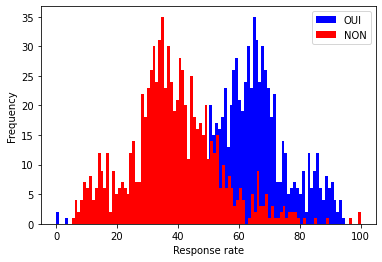

In [21]:
ax = data_oui[data_oui['taux_de_participation'] < 40]['taux_de_reponse'].plot.hist(bins=100, color='blue', label='OUI')
data_non[data_non['taux_de_participation'] < 40]['taux_de_reponse'].plot.hist(bins=100, color='red', label='NON',ax=ax)
ax.set_xlabel('Response rate')
ax.legend()

Reposnse rate "OUI": mean = 61.61 std = 14.86
Response rate "NON": mean = 38.39 std = 14.86


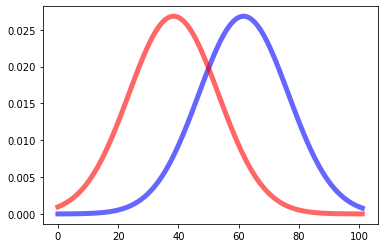

In [22]:
mu_small_oui, std_small_oui = get_normal_dist(data_oui[data_oui['taux_de_participation'] < 40]['taux_de_reponse'].values)
print('Reposnse rate "OUI": mean =', round(mu_small_oui,2), 'std =',round(std_small_oui,2))
mu_small_non, std_small_non = get_normal_dist(data_non[data_non['taux_de_participation'] < 40]['taux_de_reponse'].values)
print('Response rate "NON": mean =', round(mu_small_non,2), 'std =',round(std_small_non,2))
x = np.linspace(0, 101, 100)

fig, ax = plt.subplots(1, 1)
ax.plot(x, norm.pdf(x, mu_small_oui, std_small_oui),'b-', lw=5, alpha=0.6, label='oui fit')
ax.plot(x, norm.pdf(x, mu_small_non, std_small_non),'r-', lw=5, alpha=0.6, label='non fit')
plt.show()

and the turnout rate

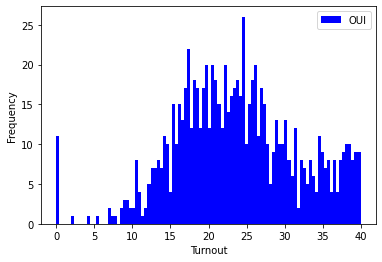

In [23]:
ax = data_oui[data_oui['taux_de_participation'] < 40]['taux_de_participation'].plot.hist(bins=100, color='blue', label='OUI')
ax.set_xlabel('Turnout')
ax.legend()

#3. Plot the results on a map.

Let us now visualize the elections results on a map.

First, we make sure that all departments are included in the txt file.

Read the geojson file with the departments borders and transform it to geopandas.

In [24]:
departments = geopandas.read_file(geofile_dpts)
departments.head()

,code,nom,geometry
0,01,Ain,"POLYGON ((4.78021 46.17668, 4.78024 46.18905, ..."
1,02,Aisne,"POLYGON ((3.17296 50.01131, 3.17382 50.01186, ..."
2,03,Allier,"POLYGON ((3.03207 46.79491, 3.03424 46.79080, ..."
3,04,Alpes-de-Haute-Provence,"POLYGON ((5.67604 44.19143, 5.67817 44.19051, ..."
4,05,Hautes-Alpes,"POLYGON ((6.26057 45.12685, 6.26417 45.12641, ..."


Define a helper function to return a sorted list from the input array. It will help to check if there is a mismatch in the list of deparments between the election data file and the geojson. 

In [25]:
def get_sorted(arr):
  return(np.sort(arr.tolist()))

Print the list of department codes in

*   the geojson file
*   the elections dataframe



In [26]:
print('Geojson:', len(departments['code'].unique()), 'departments')
print(get_sorted(departments['code'].unique()))
print('Dataframe elections:', len(data['code_departement'].unique()))
print(get_sorted(data['code_departement'].unique()))

Geojson: 96 departments
['01' '02' '03' '04' '05' '06' '07' '08' '09' '10' '11' '12' '13' '14'
 '15' '16' '17' '18' '19' '21' '22' '23' '24' '25' '26' '27' '28' '29'
 '2A' '2B' '30' '31' '32' '33' '34' '35' '36' '37' '38' '39' '40' '41'
 '42' '43' '44' '45' '46' '47' '48' '49' '50' '51' '52' '53' '54' '55'
 '56' '57' '58' '59' '60' '61' '62' '63' '64' '65' '66' '67' '68' '69'
 '70' '71' '72' '73' '74' '75' '76' '77' '78' '79' '80' '81' '82' '83'
 '84' '85' '86' '87' '88' '89' '90' '91' '92' '93' '94' '95']
Dataframe elections: 102
['01' '02' '03' '04' '05' '06' '07' '08' '09' '10' '11' '12' '13' '14'
 '15' '16' '17' '18' '19' '21' '22' '23' '24' '25' '26' '27' '28' '28'
 '29' '2A' '2B' '30' '31' '32' '33' '34' '35' '36' '37' '38' '39' '40'
 '41' '42' '43' '44' '45' '46' '47' '48' '49' '50' '51' '52' '53' '54'
 '55' '56' '57' '58' '59' '60' '62' '63' '64' '65' '66' '67' '68' '69'
 '70' '71' '72' '73' '74' '75' '75' '76' '77' '78' '79' '80' '81' '82'
 '83' '84' '85' '86' '87' '88' '89' '

There are 6 more departments in the dataframe elections file: two '28' and 'ZA', 'ZB', 'ZC', 'ZD', 'ZM'. Department 61 is missing in the elections dataframe. Probably it has been names '28' by mistake. 

Now we group the data with response 'OUI' by the code of department . Then we sum up all registered voters and all people voted for both options. We define the turnout rate (number of people voted devided by number of people registered) and the response rate (number of people voted for 'OUI' devided by number of people who voted) for each department.

We drop the data for overseas territories and convert all department names into strings. 

In [27]:
grouped = data[data['Reponse']=='OUI'].groupby('code_departement')
grouped_non = data[data['Reponse']!='OUI'].groupby('code_departement')

participation = grouped['inscrits'].sum().to_frame()
participation_non = grouped_non['inscrits'].sum().to_frame()

participation['nombre_de_voix'] = grouped['Nombre_de_voix'].sum()
participation_non['nombre_de_voix'] = grouped_non['Nombre_de_voix'].sum()
# response rate
participation['taux_de_oui'] = participation['nombre_de_voix']/(participation['nombre_de_voix']+participation_non['nombre_de_voix'])*100

participation.drop(labels=['ZA','ZB','ZC','ZD','ZM','28'],inplace=True)
participation.index = participation.index.map(str)
get_sorted(np.array(participation.index))
participation['oui_wins'] = np.where(participation['taux_de_oui']>50., 100, 0)

Show the regions where 'OUI' won (in green). In black the region for which the data is missing. In white are the regions where 'NON' won.

In [28]:
# Initialize the map and add
france = folium.Map(location=[45,5], zoom_start=5)
folium.Choropleth(geo_data=geofile_dpts,
                  data=participation['oui_wins'],
                  key_on='feature.properties.code',
                  fill_color='BuGn',
                  #fill_opacity=0.7,
                  line_opacity=0.5).add_to(france)
france

Let show the same visualization with the gradient palette representing the percentage voted for 'OUI'.

In [29]:
# Initialize the map and add
france = folium.Map(location=[45,5], zoom_start=5)
folium.Choropleth(geo_data=geofile_dpts,
                  data=participation['taux_de_oui'],
                  #data=participation[participation['taux_de_oui']<50.]['taux_de_oui'],
                  key_on='feature.properties.code',
                  bins=9,
                  fill_color='YlOrBr',
                  fill_opacity=0.7,
                  line_opacity=0.5).add_to(france)
france

## 4. Dispersion analysis

Find the standard deviation for each deparment

In [30]:
dpts_std = grouped['taux_de_reponse'].std()
for i in range(len(dpts_std)):
  print('Department code:', dpts_std.index[i], 'Std', round(dpts_std.values[i],2))

Department code: 28 Std 7.37
Department code: 29 Std 8.33
Department code: 30 Std 8.49
Department code: 31 Std 10.86
Department code: 32 Std 9.28
Department code: 33 Std 11.66
Department code: 34 Std 10.22
Department code: 35 Std 9.33
Department code: 36 Std 7.39
Department code: 37 Std 9.47
Department code: 38 Std 10.81
Department code: 39 Std 10.31
Department code: 40 Std 7.99
Department code: 41 Std 7.91
Department code: 42 Std 8.73
Department code: 43 Std 8.3
Department code: 44 Std 10.62
Department code: 45 Std 8.9
Department code: 46 Std 8.0
Department code: 47 Std 7.15
Department code: 48 Std 10.96
Department code: 49 Std 9.08
Department code: 50 Std 8.41
Department code: 51 Std 11.14
Department code: 52 Std 11.74
Department code: 53 Std 7.32
Department code: 54 Std 11.38
Department code: 55 Std 11.9
Department code: 56 Std 8.6
Department code: 57 Std 10.38
Department code: 58 Std 8.43
Department code: 59 Std 13.69
Department code: 60 Std 10.22
Department code: 62 Std 10.95
Depa

Find the region with the minimum standard deviation:

In [31]:
index_min = dpts_std.argmin()
index_max = dpts_std.argmax()

print('Department with the smallest standard deviation:')
print(dpts_std.index[index_min], round(dpts_std.values[index_min],2))

print('Department with the largest standard deviation:')
print(dpts_std.index[index_max], round(dpts_std.values[index_max],2))

Department with the smallest standard deviation:
ZM 5.14
Department with the largest standard deviation:
2B 15.84


Now we repeat the same analysis but by arrondissement. To attribute a unique identifier to each arrondissement, we merge its departement number and the arrondissement number:

In [32]:
data_oui['departement_arrondissement'] = data_oui['code_departement'].astype(str)+'_'+data_oui['code_arrondissement'].astype(str)
print('Number of arrondissement', len(data_oui['departement_arrondissement'].unique()))

Number of arrondissement 340


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


Group by the name of arrondisement and find the one with the smallest standard deviation

In [33]:
grouped_ards = data_oui.groupby('departement_arrondissement')
ards_std = grouped_ards['taux_de_reponse'].std()
ards_min = ards_std.argmin()

print('Arrondissement with the smallest standard deviation:')
print('Departement', ards_std.index[ards_min].split('_')[0], 'Arrondissement:', ards_std.index[ards_min].split('_')[1], 'STD', round(ards_std.values[ards_min],2),'%')


Arrondissement with the smallest standard deviation:
Departement 82 Arrondissement: 1 STD 4.54 %


List the communes in the arrondisement with the smallest standard deviation:

In [34]:
data_oui[data_oui['departement_arrondissement']=='82_1']['nom_de_la_commune'].unique()

array(['Beaumont-de-Lomagne ', 'Castelsarrasin', 'Cazes-Mondenard',
       'Lauzerte', 'Moissac', 'Montesquieu', 'Saint-Nicolas-de-la-Grave',
       "Saint-Paul-d'Espis", 'Tréjouls', 'Valence'], dtype=object)

Distribution of data within arrondissemnt with the smallest standard deviation

Number of units in arrondissement 34
Total number of people voted in this arrondissement 28133


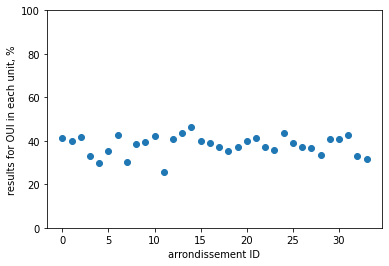

In [35]:
ards_min_val = data_oui[data_oui['departement_arrondissement']=='82_1']['taux_de_reponse'].values
x = np.arange(len(ards_min_val))

plt.scatter(x, ards_min_val)
plt.ylim([0,100])
plt.xlabel('arrondissement ID')
plt.ylabel('results for OUI in each unit, %')

print('Number of units in arrondissement', len(ards_min_val))
print('Total number of people voted in this arrondissement', data_oui[data_oui['departement_arrondissement']=='82_1']['inscrits'].sum())

# France. Referendum 2000.

# UK. BREXIT data.

Data is collected in the folder 'UK_referendum' on my gdrive.

In [36]:
%ls gdrive/My\ Drive/elections_data/UK_referendum/

EU-referendum-result-data.csv  notes.csv  summary.csv  voting_area.csv


In [37]:
import pandas as pd
import csv

df_data = pd.read_csv('gdrive/My Drive/elections_data/UK_referendum/EU-referendum-result-data.csv')
df_data.head()

,id,Region_Code,Region,Area_Code,Area,Electorate,ExpectedBallots,VerifiedBallotPapers,Pct_Turnout,Votes_Cast,Valid_Votes,Remain,Leave,Rejected_Ballots,No_official_mark,Voting_for_both_answers,Writing_or_mark,Unmarked_or_void,Pct_Remain,Pct_Leave,Pct_Rejected
0,108,E12000006,East,E06000031,Peterborough,120892,87474,87469,72.35,87469,87392,34176,53216,77,0,32,7,38,39.11,60.89,0.09
1,109,E12000006,East,E06000032,Luton,127612,84633,84636,66.31,84616,84481,36708,47773,135,0,85,0,50,43.45,56.55,0.16
2,112,E12000006,East,E06000033,Southend-on-Sea,128856,93948,93939,72.90,93939,93870,39348,54522,69,0,21,0,48,41.92,58.08,0.07
3,113,E12000006,East,E06000034,Thurrock,109897,79969,79954,72.75,79950,79916,22151,57765,34,0,8,3,23,27.72,72.28,0.04
4,110,E12000006,East,E06000055,Bedford,119530,86136,86136,72.06,86135,86066,41497,44569,69,0,26,1,42,48.22,51.78,0.08


In [38]:
df_data['Area']

0         Peterborough
1                Luton
2      Southend-on-Sea
3             Thurrock
4              Bedford
            ...       
377           Bradford
378         Calderdale
379           Kirklees
380              Leeds
381          Wakefield
Name: Area, Length: 382, dtype: object

In [39]:
df_data['Pct_Remain']

0      39.11
1      43.45
2      41.92
3      27.72
4      48.22
       ...  
377    45.77
378    44.32
379    45.33
380    50.31
381    33.64
Name: Pct_Remain, Length: 382, dtype: float64

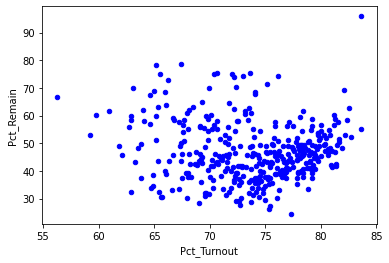

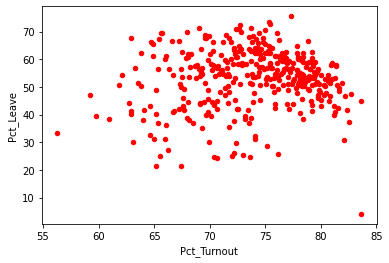

In [40]:
ax1 = df_data.plot.scatter(x='Pct_Turnout', y='Pct_Remain', color='Blue')
ax2 = df_data.plot.scatter(x='Pct_Turnout', y='Pct_Leave', color='Red')


(0.0, 100.0)

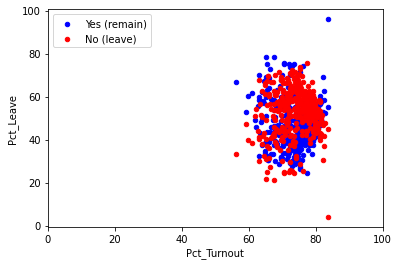

In [41]:
ax = df_data.plot(kind='scatter', x='Pct_Turnout', y='Pct_Remain', color='Blue', label='Yes (remain)')
df_data.plot(kind='scatter', x='Pct_Turnout', y='Pct_Leave', color='Red', label='No (leave)', ax=ax)
ax.set_xlim([0,100])

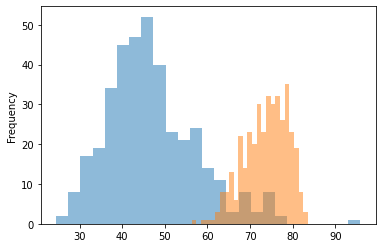

In [42]:
ax1 = df_data['Pct_Remain'].plot.hist(bins=25, alpha=0.5)
ax2 = df_data['Pct_Turnout'].plot.hist(bins=25, alpha=0.5)

In [43]:
turnout = []
avg_remain = []
avg_remain_no = []
num_avg = []
num_avg_no = []

for i in range(0,101,1):
   turnout.append(i)
   avg = df_data[(df_data['Pct_Turnout'] > i) & (df_data['Pct_Turnout'] < i+1)]['Remain']#['Pct_Remain']
   num_avg.append(len(avg))
   avg_no = df_data[(df_data['Pct_Turnout'] > i) & (df_data['Pct_Turnout'] < i+1)]['Leave']#['Pct_Remain']
   num_avg_no.append(len(avg_no))
   if len(avg) == 0:
      avg_remain.append(0)
   else:
      avg_remain.append(avg.sum())#/len(avg))
   if len(avg_no) == 0:
      avg_remain_no.append(0)
   else:
      avg_remain_no.append(avg_no.sum())#/len(avg))
print(num_avg)

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 2, 1, 1, 5, 6, 7, 11, 8, 15, 11, 21, 19, 21, 27, 22, 29, 27, 28, 23, 29, 29, 15, 13, 5, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


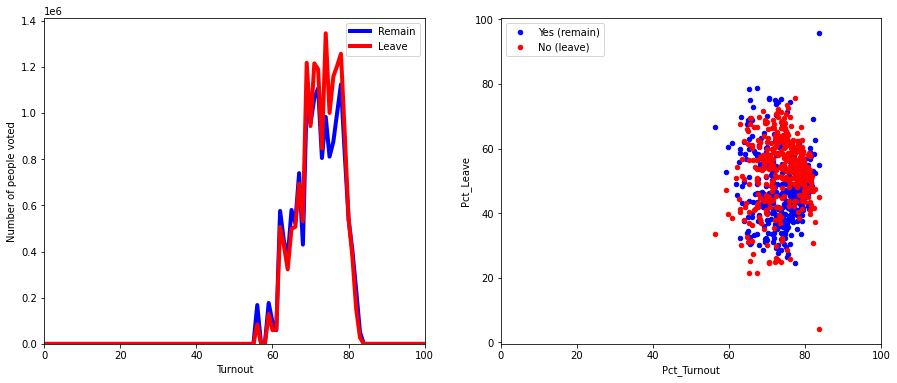

In [44]:
import matplotlib.pyplot as plt
%matplotlib inline

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(15,6))
ax1.plot(turnout, avg_remain, color='Blue', linewidth=4, label='Remain')
ax1.plot(turnout, avg_remain_no, color='Red', linewidth=4, label='Leave')
#ax.scatter(turnout, num_avg)
ax1.set_xlim([0,100])
ax1.set_ylim(ymin=0)
ax1.legend()
ax1.set_xlabel('Turnout')
ax1.set_ylabel('Number of people voted')
df_data.plot(kind='scatter', x='Pct_Turnout', y='Pct_Remain', color='Blue', label='Yes (remain)',ax=ax2)
df_data.plot(kind='scatter', x='Pct_Turnout', y='Pct_Leave', color='Red', label='No (leave)', ax=ax2)
ax2.set_xlim([0,100])
fig.savefig('UK_brexit_2016.jpg')

In [45]:
%cp UK_brexit_2016.jpg gdrive/My\ Drive/elections_data/